In [1]:
# Mount the Gdrive
from google.colab import drive
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [2]:
# Change the Current working Directory to your Gdrive
%cd /content/gdrive/MyDrive/

/content/gdrive/MyDrive


In [7]:
# Clone the github project
!git clone https://github.com/facebookresearch/segment-anything-2.git

# Change the current working Directory
%cd /content/gdrive/MyDrive/segment-anything-2



Cloning into 'segment-anything-2'...
remote: Enumerating objects: 431, done.
remote: Counting objects: 100% (125/125), done.
remote: Compressing objects: 100% (84/84), done.
remote: Total 431 (delta 82), reused 47 (delta 41), pack-reused 306
Receiving objects: 100% (431/431), 56.08 MiB | 17.59 MiB/s, done.
Resolving deltas: 100% (96/96), done.
/content/gdrive/MyDrive/segment-anything-2


In [8]:
!pip install -e .

Obtaining file:///content/gdrive/MyDrive/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for SAM-2 (pyproject.toml) ... done
  Created wheel for SAM-2: filename=SAM_2-1.0-0.editable-cp310-cp310-linux_x86_64.whl size=12061 sha256=2bd5315164e313ae2fa6f0cbb1227769331768eed67d90360ccfa3c5db465f37
  Stored in directory: /tmp/pip-ephem-wheel-cache-j0eypxu7/wheels/ed/4d/81/9b1817d4ab105ff59a1420a5fdc1cd4201b298a4285d753e79
Successfully built SAM-2
  Attempting uninstall: SAM-2
    Found existing installation: SAM-2 1.0
    Uninstalling SAM-2-1.0:
      Successfully uninstalled SAM-2-1.0


In [1]:
!pwd

/content


In [2]:
# Change the CWD to checkpoints and donwload the model weights
%cd /content/gdrive/MyDrive/segment-anything-2/checkpoints/

!bash /content/gdrive/MyDrive/segment-anything-2/checkpoints/download_ckpts.sh

/content/gdrive/MyDrive/segment-anything-2/checkpoints
--2024-08-08 13:09:00--  https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_tiny.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 18.154.144.87, 18.154.144.13, 18.154.144.102, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.154.144.87|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 155906050 (149M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2_hiera_tiny.pt.1’

sam2_hiera_tiny.pt. 100%[===================>] 148.68M  60.1MB/s    in 2.5s    

2024-08-08 13:09:03 (60.1 MB/s) - ‘sam2_hiera_tiny.pt.1’ saved [155906050/155906050]

--2024-08-08 13:09:03--  https://dl.fbaipublicfiles.com/segment_anything_2/072824/sam2_hiera_small.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 18.154.144.87, 18.154.144.13, 18.154.144.102, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|18.154.144.87|:443... connected.
HTTP request sent, 

In [3]:
# Change the Current working Directory to the root of the project
%cd /content/gdrive/MyDrive/segment-anything-2/

/content/gdrive/MyDrive/segment-anything-2


# Video segmentation with SAM 2

In [4]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [5]:
# use bfloat16 for the entire notebook
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

### Loading the SAM 2 video predictor

In [6]:
from sam2.build_sam import build_sam2_video_predictor

sam2_checkpoint = "./checkpoints/sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"

predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint)

/content/gdrive/MyDrive/segment-anything-2/sam2/modeling/sam/transformer.py:23: UserWarning: Flash Attention is disabled as it requires a GPU with Ampere (8.0) CUDA capability.
  OLD_GPU, USE_FLASH_ATTN, MATH_KERNEL_ON = get_sdpa_settings()


In [7]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=200):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

In [11]:
!apt-get update
!apt-get install ffmpeg


Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:3 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Ign:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Get:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [920 kB]
Get:8 https://r2u.stat.illinois.edu/ubuntu jammy Release [5,713 B]
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy Release.gpg [793 B]
Hit:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Get:11 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [2,119 kB]
Hit:12 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:13 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,218 kB]
Hit:14 

In [8]:
import os

# Create output directory
output_dir = '/content/frames'
os.makedirs(output_dir, exist_ok=True)

# Extract frames using ffmpeg
!ffmpeg -i /content/vecteezy_people-women-wearing-glasses-woman-glasses-in-eyeglasses_24491598.mp4 -q:v 2 -start_number 0 /content/frames/%05d.jpg


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

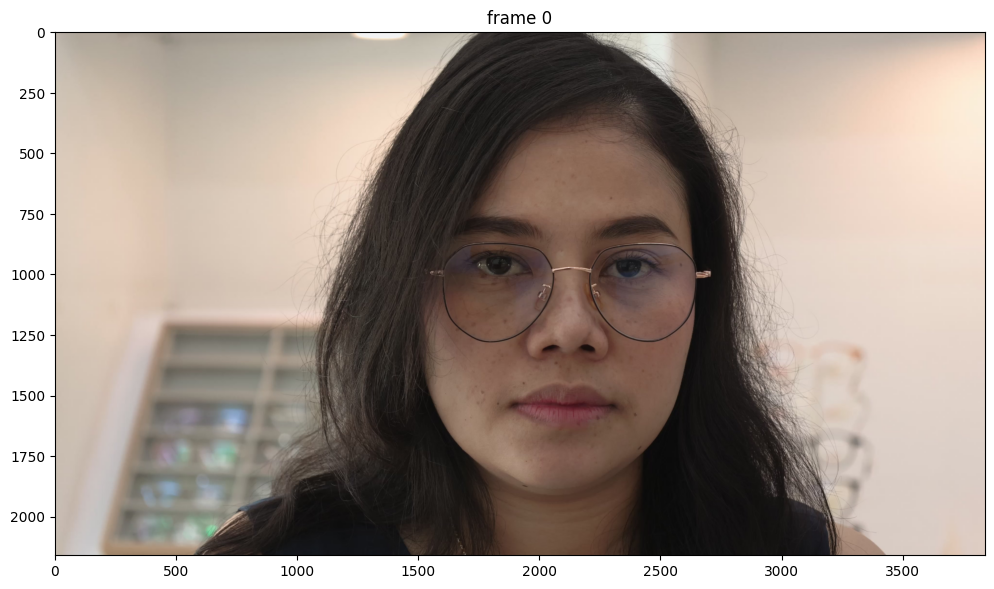

In [9]:
# `video_dir` a directory of JPEG frames with filenames like `<frame_index>.jpg`
video_dir = "/content/frames"

# scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))

# take a look the first video frame
frame_idx = 0
plt.figure(figsize=(12, 8))
plt.title(f"frame {frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

In [10]:
inference_state = predictor.init_state(video_path=video_dir)

frame loading (JPEG): 100%|██████████| 874/874 [02:18<00:00,  6.33it/s]


In [11]:
predictor.reset_state(inference_state)

/content/gdrive/MyDrive/segment-anything-2/sam2/sam2_video_predictor.py:869: UserWarning: /content/gdrive/MyDrive/segment-anything-2/sam2/_C.so: undefined symbol: _ZN3c1015SmallVectorBaseIjE8grow_podEPKvmm

Skipping the post-processing step due to the error above. Consider building SAM 2 with CUDA extension to enable post-processing (see https://github.com/facebookresearch/segment-anything-2/blob/main/INSTALL.md).
  pred_masks_gpu = fill_holes_in_mask_scores(


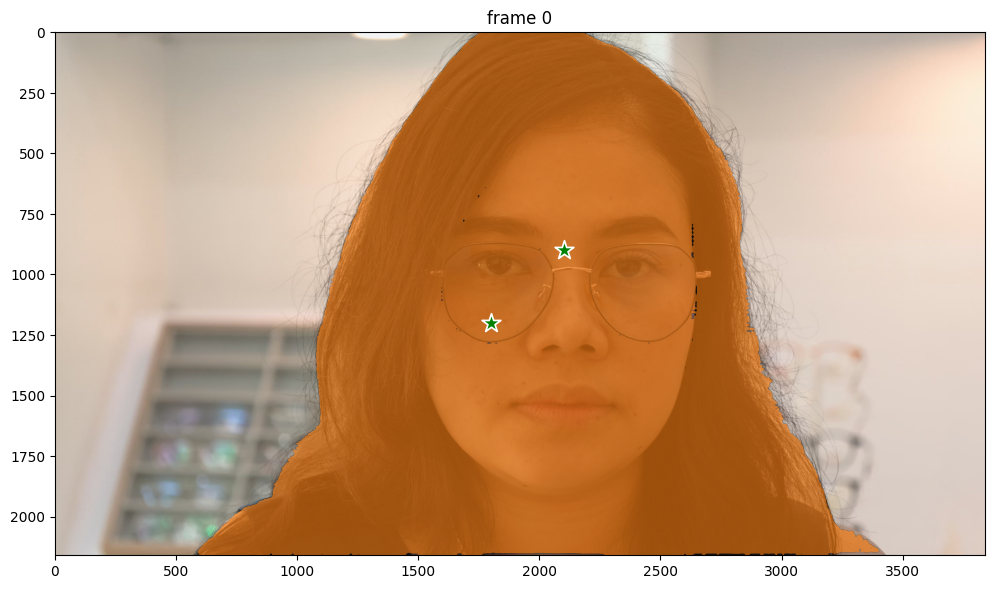

In [12]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with

# Add positive clicks near the glasses
points = np.array([[2100, 900], [1800, 1200]], dtype=np.float32)  # Adjusted points for better focus on glasses
labels = np.array([1, 1], np.int32)  # Both are positive clicks

# Apply the new points to the SAM predictor
_, out_obj_ids, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# Display the results
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())

# Adjust mask display threshold as needed
show_mask((out_mask_logits[0] > 0.5).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])  # Threshold can be adjusted
plt.show()


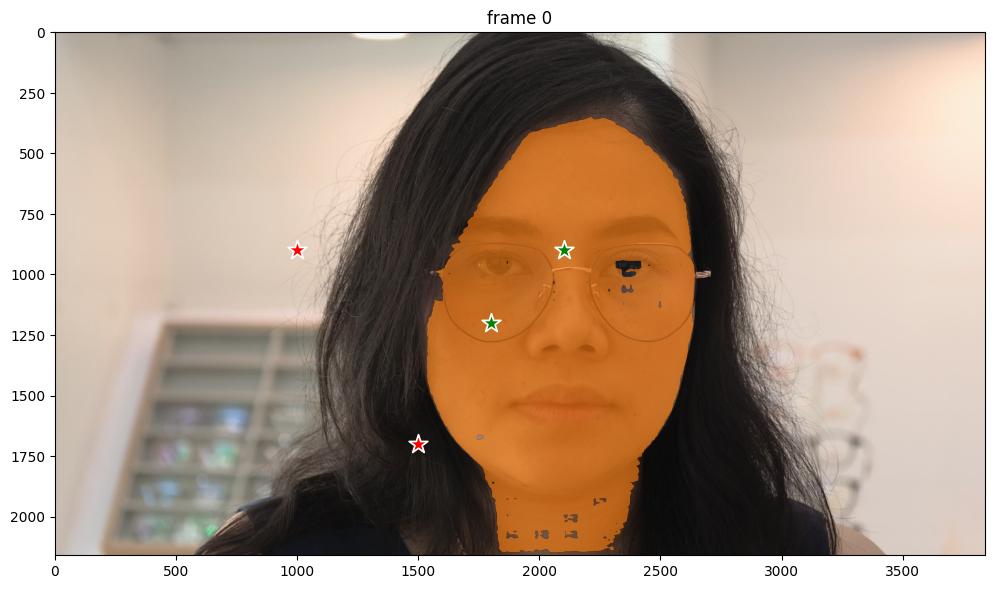

In [13]:
aann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with

# Positive clicks on the glasses
points = np.array([[2100, 900], [1800, 1200]], dtype=np.float32)  # Adjust points as needed
labels = np.array([1, 1], np.int32)  # Positive clicks

# Add negative clicks on other parts of the face
negative_points = np.array([[1000, 900], [1500, 1700]], dtype=np.float32)  # Adjust to exclude areas like forehead, chin
negative_labels = np.array([0, 0], np.int32)  # Negative clicks

# Combine the points and labels
points = np.concatenate((points, negative_points), axis=0)
labels = np.concatenate((labels, negative_labels), axis=0)

# Apply the updated points to the SAM predictor
_, out_obj_ids, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# Display the results
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())

# Adjust mask threshold for a tighter fit
show_mask((out_mask_logits[0] > 0.6).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])  # Threshold adjustment
plt.show()


propagate in video: 100%|██████████| 874/874 [16:55<00:00,  1.16s/it]


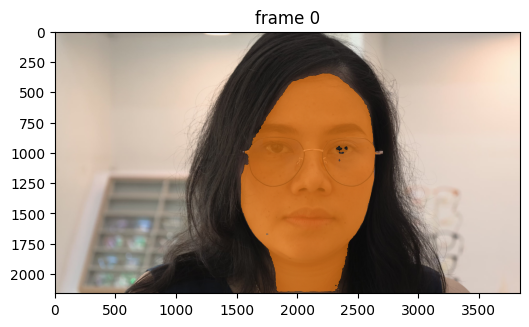

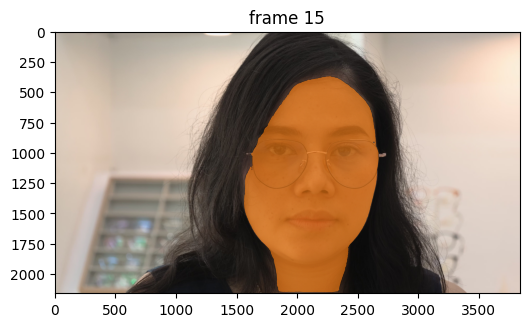

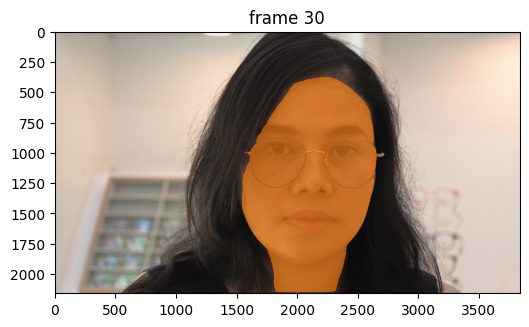

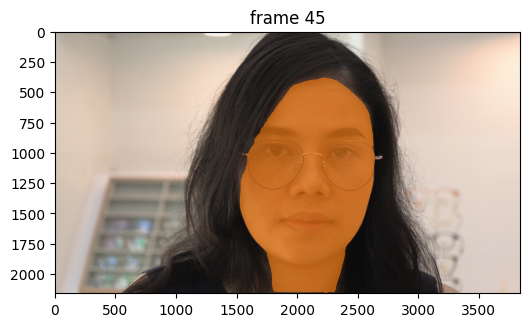

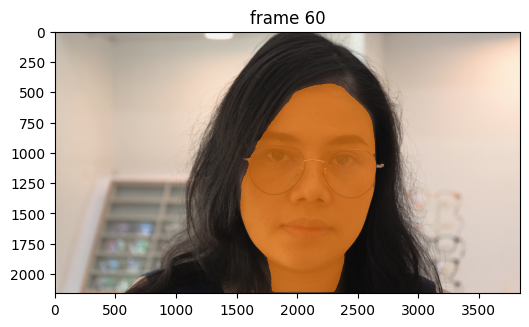

...

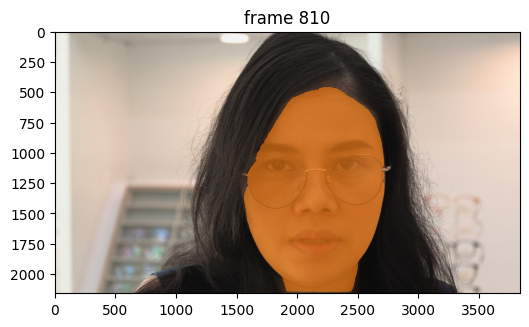

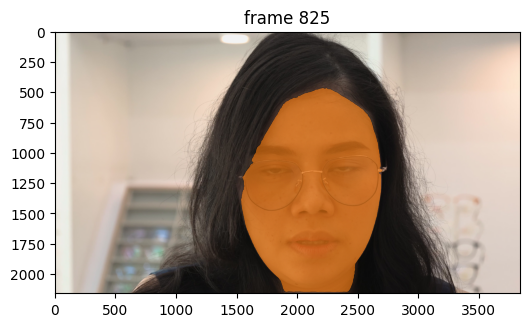

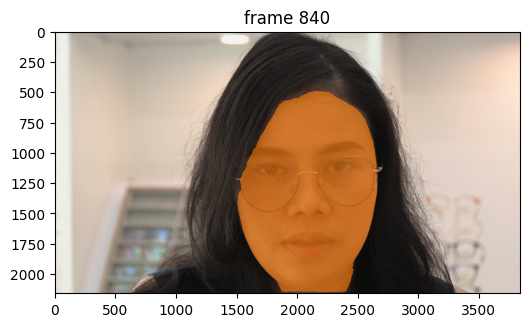

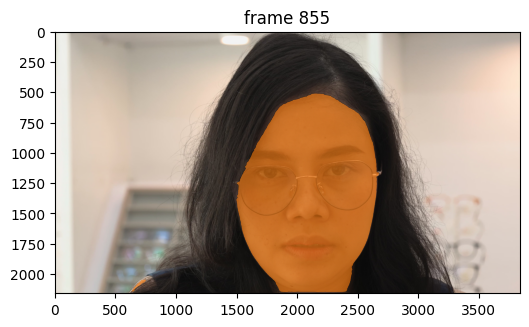

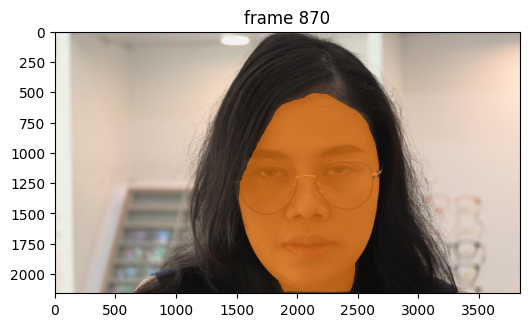

In [14]:
# Only process every nth frame to reduce memory usage
n = 5  # Process every 5th frame, adjust this as needed
video_segments = {}  # video_segments contains the per-frame segmentation results

for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    if out_frame_idx % n == 0:
        video_segments[out_frame_idx] = {
            out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
            for i, out_obj_id in enumerate(out_obj_ids)
        }

# Now, render the segmentation results every few frames
vis_frame_stride = 15
plt.close("all")
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    if out_frame_idx in video_segments:
        plt.figure(figsize=(6, 4))
        plt.title(f"frame {out_frame_idx}")
        plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
        for out_obj_id, out_mask in video_segments[out_frame_idx].items():
            show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
        plt.show()


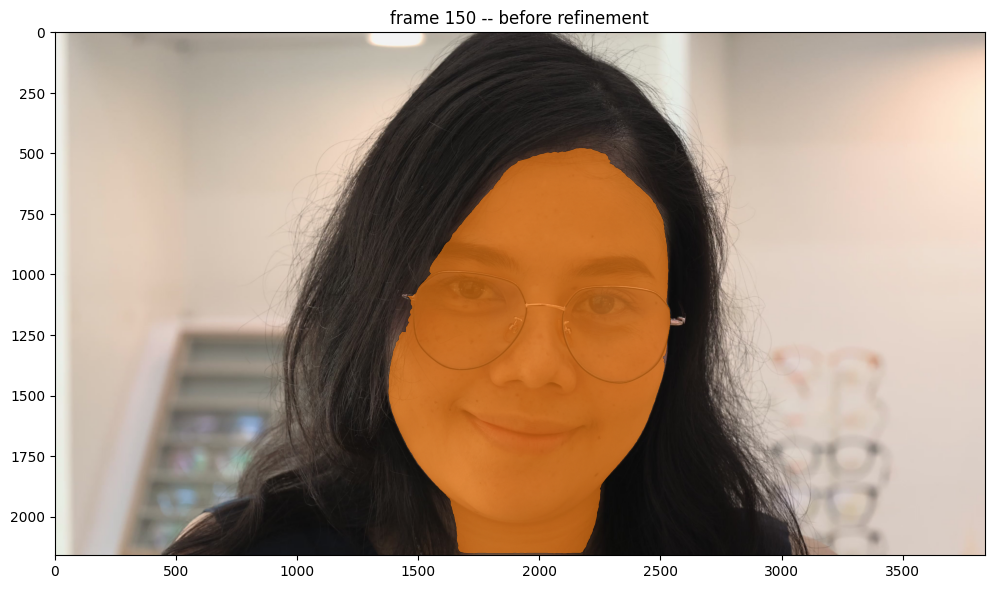

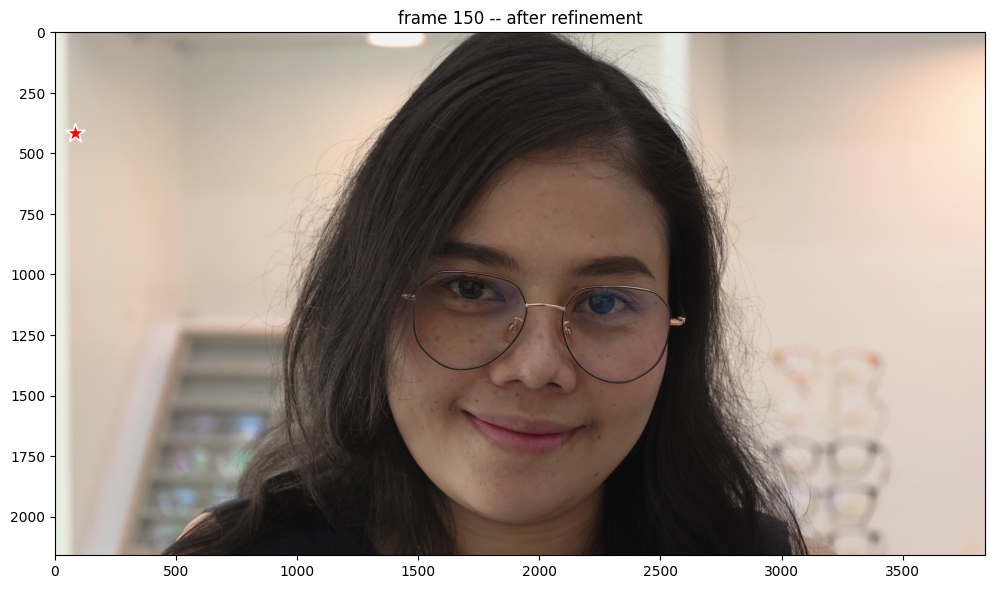

In [15]:
ann_frame_idx = 150  # further refine some details on this frame
ann_obj_id = 1  # give a unique id to the object we interact with (it can be any integers)

# show the segment before further refinement
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx} -- before refinement")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_mask(video_segments[ann_frame_idx][ann_obj_id], plt.gca(), obj_id=ann_obj_id)

# Let's add a negative click on this frame at (x, y) = (82, 415) to refine the segment
points = np.array([[82, 415]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([0], np.int32)
_, _, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# show the segment after the further refinement
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx} -- after refinement")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits > 0.0).cpu().numpy(), plt.gca(), obj_id=ann_obj_id)

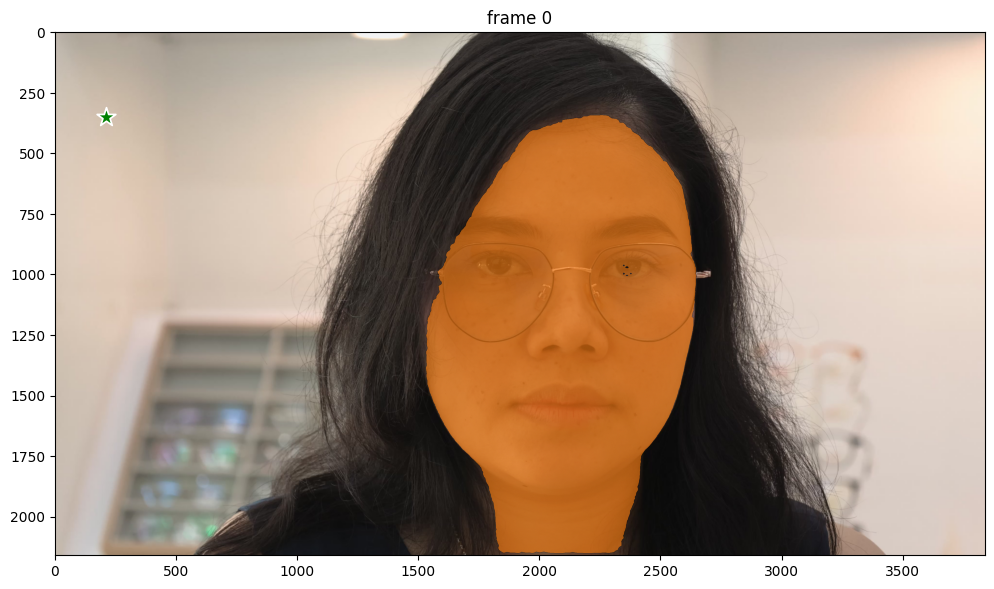

propagate in video: 100%|██████████| 874/874 [17:50<00:00,  1.23s/it]


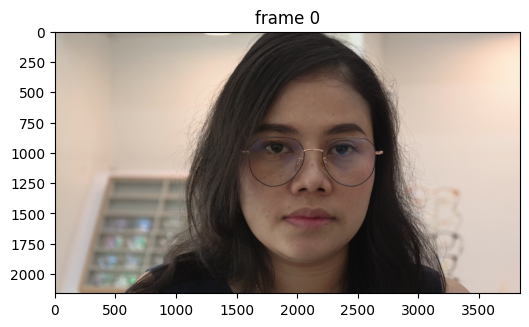

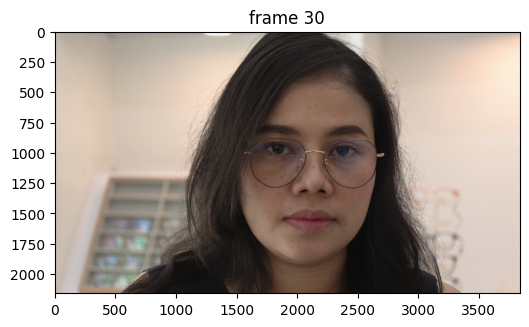

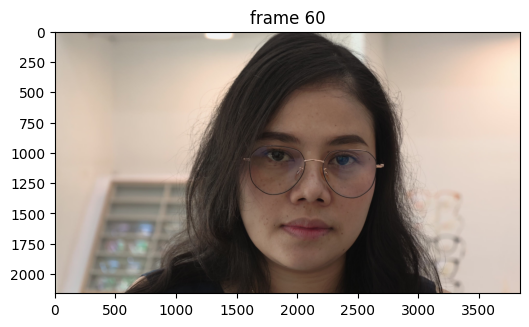

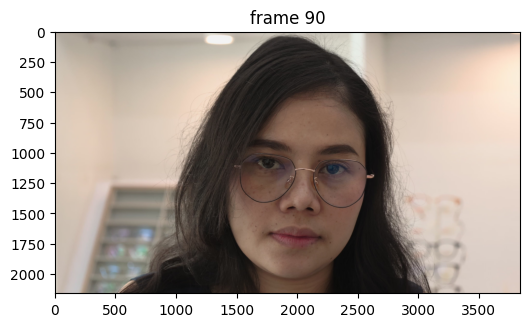

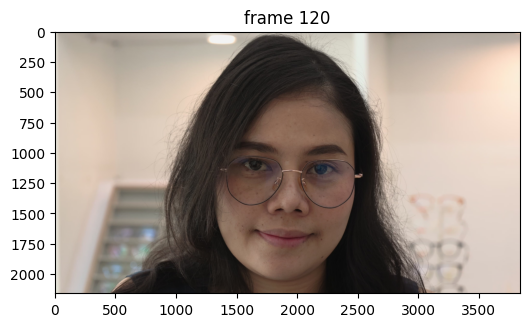

...

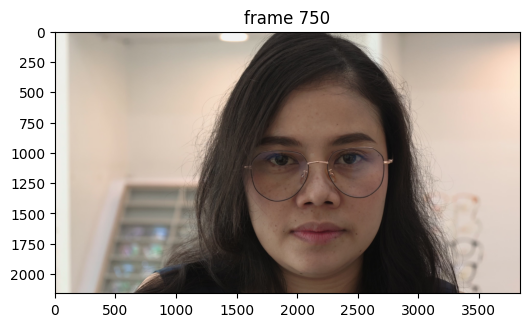

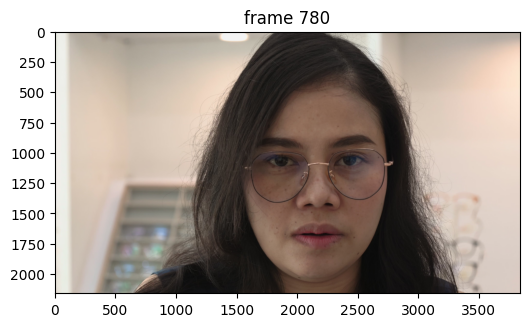

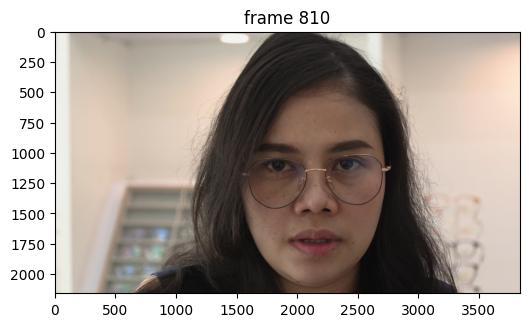

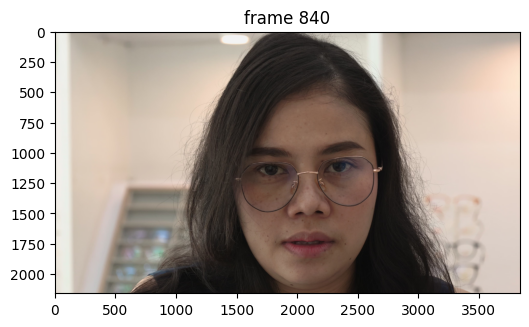

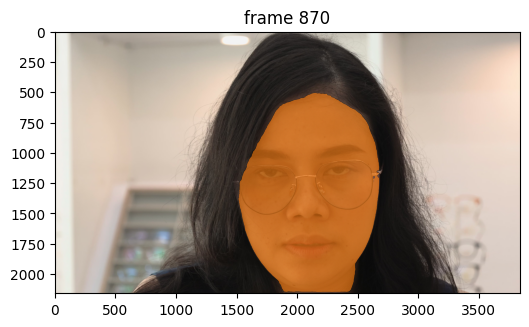

KeyError: 150

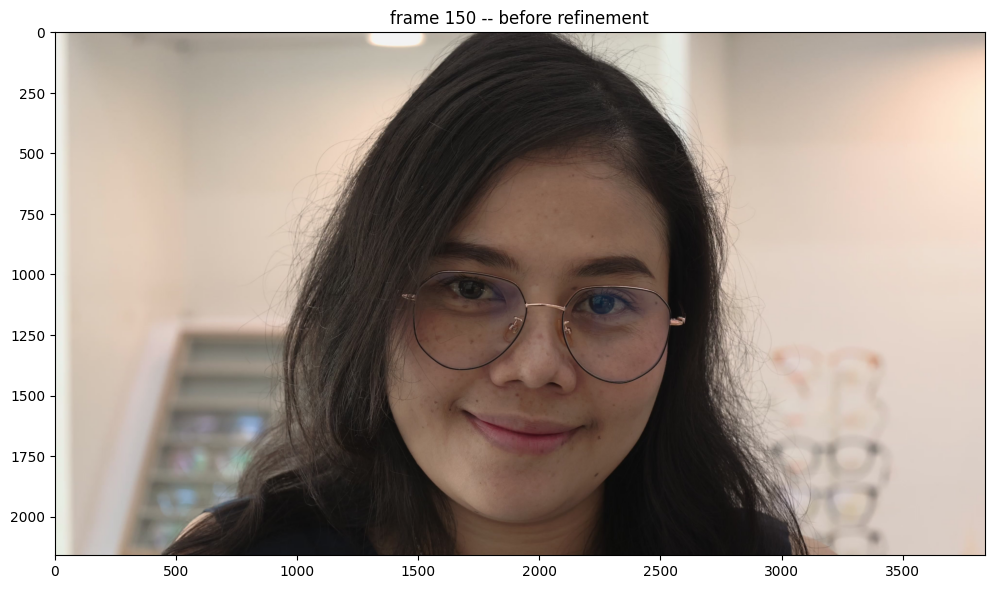

In [16]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pickle

# Assuming `predictor`, `inference_state`, `video_dir`, and `frame_names` are already defined

# Define parameters
ann_frame_idx = 0  # Starting frame index for interaction
ann_obj_id = 1  # Object ID to interact with
points = np.array([[210, 350]], dtype=np.float32)  # Initial positive click
labels = np.array([1], np.int32)  # Label for the initial click (1 for positive)

# Add initial point and get the segmentation mask
_, out_obj_ids, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# Show the initial segmentation result on the interacted frame
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])
plt.show()

# Run propagation throughout the video and collect the results in batches
video_segments = {}  # Dictionary to store segmentation results
batch_size = 50  # Number of frames to process before saving and clearing memory

for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

    # Save and clear memory every batch_size frames
    if (out_frame_idx + 1) % batch_size == 0:
        # Save the batch of video segments to a file
        with open(f"video_segments_{out_frame_idx//batch_size}.pkl", "wb") as f:
            pickle.dump(video_segments, f)
        video_segments.clear()  # Clear memory to avoid crashes

# Render the segmentation results every few frames (adjust vis_frame_stride to control frequency)
vis_frame_stride = 30  # Increase stride to visualize fewer frames

for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments.get(out_frame_idx, {}).items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
    plt.show()
    plt.close()  # Clear the figure from memory

# Refine segmentation on a specific frame if needed
ann_frame_idx = 150  # Frame index for further refinement
ann_obj_id = 1  # Object ID to refine
points = np.array([[82, 415]], dtype=np.float32)  # Negative click position
labels = np.array([0], np.int32)  # Label for the negative click (0 for negative)

# Show the segment before further refinement
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx} -- before refinement")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_mask(video_segments[ann_frame_idx][ann_obj_id], plt.gca(), obj_id=ann_obj_id)
plt.show()

# Add the negative point and get the refined segmentation mask
_, _, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

# Show the segment after the further refinement
plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx} -- after refinement")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits > 0.0).cpu().numpy(), plt.gca(), obj_id=ann_obj_id)
plt.show()
